# <center> Trabajo Practico N1: Redes Convolucionales </center>
<center>
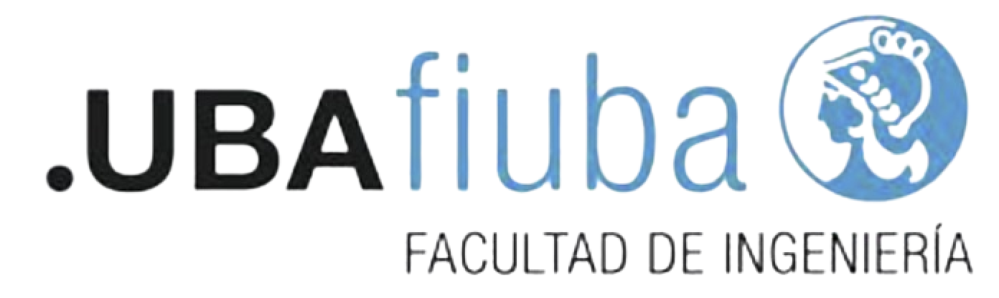
</center>

### <center>José Mornaghi y Lucas Argento</center>
 



> ##  Introducción


Con el objetivo de estudiar las redes neuronales convolucionales, sus aplicaciones y su diseño, se analizó un dataset público sobre imagenes MRI de pacientes con distintos grados de la enfermedad de Alzheimer. El objetivo del estudio fue clasificar las imagenes de entrada en 4 clases distintas, cada una indicando un distinto grado de avance de la enfermedad.

Para esto, se utilizó una red neuronal convolucional, para la cual se estudiaron diferentes decisiones de diseño y valores de sus hiperparamétros.

> ## Sobre los datos

El dataset público "Alzheimer MRI Preprocessed Dataset", disponible en Kaggle, contiene imágenes de 4 clases diferentes en tamaños de 128 x 128 pixeles.

Los datos fueron recolectados de diferentes paginas web, hospitales y repositoros públicos. Consisten en imagánes preprocesdad de resonancias magneticas MRI (por sus siglas en inglés Magnetic Resonance Imaging)

El dataset consiste en un total de 6400 imágenes, pertenecientes a una de las siguientes clases:
Clase - 1: Mild Demented (896 imágenes)
Clase - 2: Moderate Demented (64 imágenes)
Clase - 3: Non Demented (3200 imágenes)
Clase - 4: Very Mild Demented (2240 imágenes)

Elegimos este dataset en particular ya que consideramos que las CNNs tienen un potencial genuino para resolver este tipo de problemas en la vida real, agregando valor y mejorando la vida de las personas. 

Referencias:

* https://adni.loni.usc.edu/
* https://www.alzheimers.net/
* https://www.kaggle.com/datasets/jboysen/mri-and-alzheimers
* https://ieeexplore.ieee.org/document/9521165
* https://catalog.data.gov/dataset/alzheimers-disease-and-healthy-aging-data
* https://www.nature.com/articles/s41598-020-79243-9
* https://cordis.europa.eu/article/id/429468-the-final-epad-dataset-is-now-available-on-the-alzheimer-s-disease-workbench

> ## Librerias a utilizar 

In [1]:
%pip install torch torchvision

Note: you may need to restart the kernel to use updated packages.


In [2]:
%pip install pandas

Note: you may need to restart the kernel to use updated packages.


In [3]:
%pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.cuda

import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from torchvision import datasets
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler

from utils import train_model, compute_confusion_matrix

from plot_utils import plot_training_loss, plot_accuracy, show_examples, plot_confusion_matrix

> ## Visualizacion de las clases

Tenemos 4 clases de demencia asociadas a distintos niveles de Alzheimer. A continuacion mostramos ejemplos de MRI's para los distintos niveles mencionados:

In [2]:
class_names = ['Mild_Demented', 'Moderate_Demented', 'Non_Demented', 'Very_Mild_Demented']

In [3]:
#%pip install ipyplot
import ipyplot

images = ["Dataset/Mild_Demented/mild_10.jpg","Dataset/Moderate_Demented/moderate_10.jpg","Dataset/Non_Demented/non_10.jpg","Dataset/Very_Mild_Demented/verymild_10.jpg"]

ipyplot.plot_images(images, class_names, img_width=150)

> ## Carga de los datos y separación en sets de entrenamiento, validación y testeo

> _Split folders es un paquete que facilita el proceso de hacer un test-train-split con carpetas de imágenes_

In [4]:
#!pip install split-folders
import splitfolders
splitfolders.ratio('Dataset', output="output", seed=123, ratio=(.8, 0.1,0.1))

Copying files: 6400 files [00:28, 225.23 files/s]


In [4]:
# Como se menciono antes, nuestro dataset contiene imagenes en 128x128
IMG_HEIGHT = 128
IMG_WIDTH = 128

# Transformamos a tensores para poder procesar las imagenes con PyTorch
transform = transforms.ToTensor()

# Transformaciones y loadding
train_data = datasets.ImageFolder(root='output/train',transform=transform)
test_data = datasets.ImageFolder(root='output/test',transform=transform)
val_data = datasets.ImageFolder(root='output/val',transform=transform)

> ## Arquitectura Propuesta

Para el estudio de las CNNs, decidimos partir de la arquitectura original de la Red Neuronal **LeNet** (1998), la cual luego modificaremos para estudiar los efectos de las distintas decisiones de diseño. 
A continuacion, se observa un esquema de la arquitectura original, compuesta por dos capas convolucionales y 3 capas FullyConnected de Perceptrones Multicapa. Si bien la red original usaba funciones de activacion de tangenge hiperbólica, en nuestro caso se utilizaron funciones ReLu.

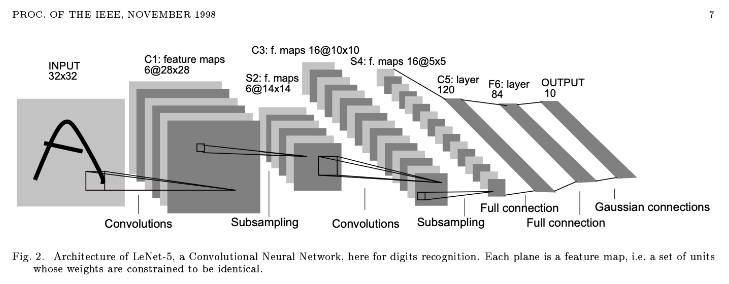

> La siguiente imagen es la formula que devuelve el output size despues de una capa de pooling.

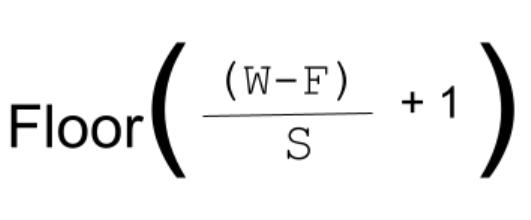

In [31]:
class LeNet5(nn.Module):

    def __init__(self, n_canales_rgb, n_clases, cantidad_filtros_conv, tamaño_filtro_conv, 
                 tamaño_kernel_pooling, stride, padding):
        super().__init__()
        # cantidad de canales y clases, a definir por el diseñador
        self.n_canales_rgb = n_canales_rgb
        self.n_clases = n_clases
        self.tamaño_kernel_pooling = tamaño_kernel_pooling
        # Le net tiene dos capas convolucionales
        self.conv1 = nn.Conv2d(self.n_canales_rgb, cantidad_filtros_conv, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv1 = math.floor(((128 - tamaño_filtro_conv + 2 * padding)/stride) + 1)
        # outputconv1 = math.floor(((128 - tamaño_filtro_conv)/stride))
        # falta un +1 al final ?? tener en cuenta el padding
        # asi seria? outputconv1 = math.floor(((128 - tamaño_filtro_conv + 2* padding)/stride) + 1)
        
        print("imagenes de salida post convolucion1:", outputconv1, "x", outputconv1)
        outputconv1 = math.floor(((outputconv1 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling1:", outputconv1, "x", outputconv1)
        
        self.conv2 = nn.Conv2d(cantidad_filtros_conv, cantidad_filtros_conv*4, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv2 = math.floor((((outputconv1 - tamaño_filtro_conv)+ 2 * padding)/stride) + 1)
        print("imagenes de salida post convolucion2:", outputconv2, "x", outputconv2)
        outputconv2 = math.floor(((outputconv2 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling2:", outputconv2, "x", outputconv2)

        # size del vector de parametros luego de las capas convolucionales
        cantidad_parametros = math.floor(cantidad_filtros_conv *4 * outputconv2 * outputconv2)
        print("cantidad de parametros en unrolling:",cantidad_parametros)
        # y tres capas de MLPs
        
        # primer MLP
        inputfc1 = math.floor(cantidad_parametros)
        print("parametros de entrada del primer perceptron:", inputfc1)
        outputfc1 = math.floor((1/2)*inputfc1)
        print("parametros de salida del primer perceptron:", outputfc1)
        
        self.fc1 = torch.nn.Linear(inputfc1, outputfc1)
        # segundo MLP
        inputfc2 = outputfc1
        print("parametros de entrada del segundo perceptron:", inputfc2)
        outputfc2 = math.floor(inputfc2*(1/2))
        print("parametros de salida del segundo perceptron:", outputfc2)
        self.fc2 = torch.nn.Linear(inputfc2, outputfc2)
        # tercer MLP. salida con cantidad de clases
        inputfc3 = outputfc2
        print("parametros de entrada del tercer perceptron:", inputfc3)
        self.fc3 = torch.nn.Linear(inputfc3, self.n_clases)

    def forward(self, x):
        # capa convolucional
        x = self.conv1(x)
        # al resultado de la convolucion, le aplica una ReLu
        x = F.relu(x)
        # y luego un pooling
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        
        # Segunda capa convolucional
        x = self.conv2(x)
        # aplica relu
        x = F.relu(x)
        # pooling 
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        
        # flatten de las imagenes para pasarlo a MLPs
        x = torch.flatten(x, 1)
        # MLPs con relus
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        
        return x

> _Puesto que variaremos los hiperparametros de nuestra red en reiteradas ocaciones, vamos a modularizar el proceso de creación y entrenamiento del modelo a través de una función_

In [32]:
def crear_modelo(cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding):
    # Instanciamos la clase del modelo:
    model = LeNet5(3, 4, cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding)
    # CUDA / CPU
    model = model.to('cpu')
    return model

In [52]:
def entrenar_modelo(model, optimizer, epocas, batch_size, train_data, val_data, test_data):
    # Cargamos data en PyTorch
    train_loader = torch.utils.data.DataLoader(train_data,
                                               batch_size=batch_size,
                                               shuffle = True,                                        
                                               num_workers=0)

    valid_loader = torch.utils.data.DataLoader(val_data,
                                               batch_size=batch_size,
                                               shuffle = True,
                                               num_workers=0)

    test_loader = torch.utils.data.DataLoader(test_data,
                                              batch_size=batch_size,
                                              shuffle = True,
                                              num_workers=0)
    
    # Entrenamiento del modelo
    minibatch_loss_list, train_acc_list, valid_acc_list = train_model(
        model=model,
        num_epochs=NUM_EPOCAS,
        train_loader=train_loader,
        valid_loader=valid_loader,
        test_loader=test_loader,
        optimizer=optimizer,
        device='cpu',
        log_interval_batch=5)
    # Devuelvo listas para controlar el desempeño del entrenamiento
    return minibatch_loss_list, train_acc_list, valid_acc_list, train_loader

> _La optimización de la red se realizará con el algoritmo del descenso del gradiente estocástico_

> ## Primer modelo y entrenamiento

In [8]:
model_1= crear_modelo(16, 2, 2, 2, 0)

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
parametros de entrada del primer perceptron: 4096
parametros de salida del primer perceptron: 2048
parametros de entrada del segundo perceptron: 2048
parametros de salida del segundo perceptron: 1024
parametros de entrada del tercer perceptron: 1024


In [9]:
optimizer = torch.optim.Adam(model_1.parameters(), lr=0.001)

> La eleccion del optimizer lo hicimos en base al siguiente paper.

https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7407771/#:~:text=The%20Adam%20optimizer%20had%20the,ability%20in%20classification%20and%20segmentation

In [12]:
NUM_EPOCAS = 3
valid_size = 0.2
batch_size = 128

In [13]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_1, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[  0.2901,  -4.6317,   0.3774,   1.2589],
        [ -1.1297,  -5.3015,   1.5033,   1.3236],
        [ -3.8077,  -9.0223,   4.4232,   1.5451],
        [ -0.3703,   0.4671,  -0.5984,   0.0645],
        [ -2.5973,  -9.0605,   3.9182,   1.3912],
        [ -0.4473,  -6.0525,   1.2341,   1.4566],
        [ -0.3898,  -5.1967,   0.6365,   1.6462],
        [ -4.1909,  -9.1680,   4.8601,   1.3648],
        [ -0.6010,  -6.8443,   1.8846,   1.2850],
        [ -3.0706,  -8.7821,   3.7981,   1.6700],
        [ -0.8949,  -5.9443,   1.7284,   1.2401],
        [ -4.5008, -11.9781,   5.4236,   2.1873],
        [ -0.6545,  -5.7059,   1.2483,   1.4757],
        [ -0.1925,  -5.4167,   0.2272,   2.0003],
        [ -0.3772,  -6.9022,   1.7772,   1.2498],
        [ -1.2129,  -5.7821,   1.5212,   1.5571],
        [ -0.9372,  -5.4331,   1.2661,   1.4994],
        [ -2.1246,  -7.3229,   2.7853,   1.5306],
        [ -2.7226,  -7.8128,   3.1539,   1.6969],
        [ -1.8094,  -7.7363, 

> Nuestro primer Modelo logra una Accuracy en el Test de Entrenamiento del **86.61%.**
Realizamos 3 epochs, un batch size de 128 y un learning rate de 0.001 utilizando Adam Optimizer.

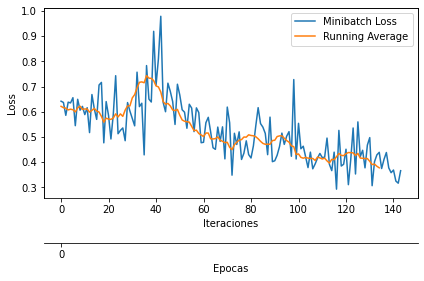

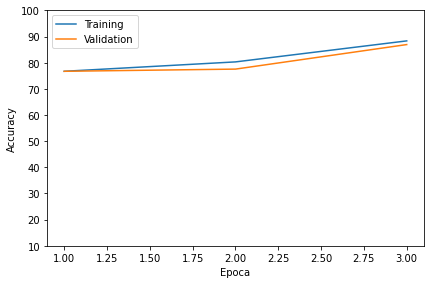

In [19]:
# Plot function de utils
plot_training_loss(minibatch_loss_list = minibatch_loss_list,
                   num_epochs = NUM_EPOCAS,
                   iter_per_epoch = len(train_loader),
                   averaging_iterations = 10)
plt.show()

plot_accuracy(train_acc_list=train_acc_list,
              valid_acc_list=valid_acc_list)
plt.ylim([10, 100])
plt.show()

> ## Ejercicio 1: Variación de Hiperparámetros


**A) Modificar la cantidad de canales (filtros) de la capa convolucional, el tamaño del kernel de convolución y el tamaño del kernel de pooling.**

Sabemos que existe una relación de dimensiones entre el tamaño del kernel de convolución, la cantidad de filtros y el tamaño del kernel de pooling, el stride y el padding.\
En la siguiente imágen podemos observar como se relacionan estos parámetros, capa a capa.

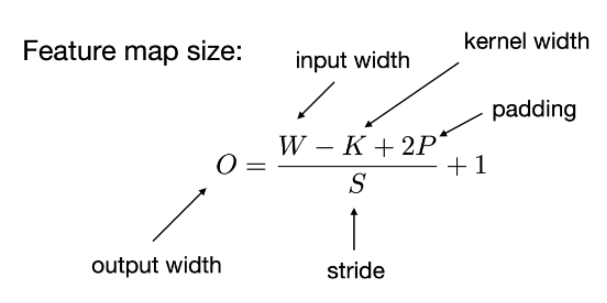

Luego de la última capa de convolución, se realiza un unrolling de los parametros para vectorizarlos y poder ingresarlos al primer perceptron (primera capa fully connected).\
Dicho vector de parametros tendra un tamaño de **FeatureMapSizeLastConv** x **FeatureMapSizeLastConv** x **CantidadFiltrosLastConv**.\
Donde **FeatureMapSizeLastConv** es la dimension de las imágenes luego de la ultima capa de convolución y pooling (las capas de pooling dividen la dimension en N veces, siendo N la dimensión del filtro de pooling).

Cada perceptron debera recibir como input la cantidad de parametros de salida de la capa anterior, y el ultimo de ellos debera tener como output la cantidad de clases a predecir, en el ejemplo de un problema de clasificación.

In [34]:
model_2 = crear_modelo(24, 3, 2, 2, 0)
optimizer = torch.optim.Adam(model_2.parameters(), lr=0.001)
NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 63 x 63
imagenes de salida post pooling1: 31 x 31
imagenes de salida post convolucion2: 15 x 15
imagenes de salida post pooling2: 7 x 7
cantidad de parametros en unrolling: 4704
parametros de entrada del primer perceptron: 4704
parametros de salida del primer perceptron: 2352
parametros de entrada del segundo perceptron: 2352
parametros de salida del segundo perceptron: 1176
parametros de entrada del tercer perceptron: 1176


In [47]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_2, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[0.0238, 0.0505, 0.0099, 0.0163],
        [0.0256, 0.0502, 0.0137, 0.0131],
        [0.0259, 0.0468, 0.0124, 0.0130],
        [0.0260, 0.0517, 0.0077, 0.0115],
        [0.0275, 0.0509, 0.0123, 0.0128],
        [0.0237, 0.0484, 0.0141, 0.0145],
        [0.0296, 0.0459, 0.0120, 0.0123],
        [0.0241, 0.0506, 0.0137, 0.0136],
        [0.0249, 0.0496, 0.0155, 0.0129],
        [0.0264, 0.0551, 0.0085, 0.0147],
        [0.0217, 0.0515, 0.0106, 0.0159],
        [0.0234, 0.0501, 0.0124, 0.0140],
        [0.0234, 0.0505, 0.0075, 0.0145],
        [0.0250, 0.0516, 0.0093, 0.0129],
        [0.0264, 0.0512, 0.0114, 0.0143],
        [0.0263, 0.0523, 0.0117, 0.0118],
        [0.0247, 0.0505, 0.0109, 0.0129],
        [0.0259, 0.0504, 0.0128, 0.0122],
        [0.0249, 0.0484, 0.0130, 0.0135],
        [0.0236, 0.0506, 0.0116, 0.0129],
        [0.0218, 0.0533, 0.0096, 0.0155],
        [0.0230, 0.0528, 0.0080, 0.0145],
        [0.0242, 0.0507, 0.0135, 0.0158],
        [0.02

>En nuestro modelo definido anteriormente, definimos el valor de la cantidad de filtros convolucionales en 16.\
Realizamos una combinacion distinta. Cambiando el valor de cantidad de filtros a 24, aumentando la dimension de los filtros convolucionales de 2x2 a 3x2, aumentando la cantidad de epocas de 3 a 10, la performance subio significativamente a **96.45%**

> Nuevo Modelo en el cual vamos a iterar cambiando solo el tamaño del filtro convolucional.

In [81]:
model_3 = crear_modelo(16, 2, 3, 2, 0)
optimizer = torch.optim.Adam(model_3.parameters(), lr=0.001)
NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 31 x 31
imagenes de salida post convolucion2: 15 x 15
imagenes de salida post pooling2: 7 x 7
cantidad de parametros en unrolling: 3136
parametros de entrada del primer perceptron: 3136
parametros de salida del primer perceptron: 1568
parametros de entrada del segundo perceptron: 1568
parametros de salida del segundo perceptron: 784
parametros de entrada del tercer perceptron: 784


In [82]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_3, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

RuntimeError: mat1 and mat2 shapes cannot be multiplied (128x576 and 3136x1568)

> Error de dimensiones

**B) Incorporar padding y stride distintos a los valores por defecto. Explicar en qué consisten estos conceptos**

El **Stride** es, en pocas palabras, el desplazamiento del filtro convolucional a traves de la imagen.\
El **Padding** es una tecnica que aumenta los bordes de las imagenes, matricialmente agregando ceros en las esquinas para que el filtro tenga mayor libertad de desplazamiento y pueda darse una mejor capacidad de prediccion

> Modelo 4\
Stride = 3

In [89]:
model_4= crear_modelo(16, 2, 2, 3, 0)
optimizer = torch.optim.Adam(model_4.parameters(), lr=0.001)
NUM_EPOCAS = 1
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 43 x 43
imagenes de salida post pooling1: 14 x 14
imagenes de salida post convolucion2: 5 x 5
imagenes de salida post pooling2: 2 x 2
cantidad de parametros en unrolling: 256
parametros de entrada del primer perceptron: 256
parametros de salida del primer perceptron: 128
parametros de entrada del segundo perceptron: 128
parametros de salida del segundo perceptron: 64
parametros de entrada del tercer perceptron: 64


In [ ]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_4, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

> Modelo 5.\
Padding = 1

In [93]:
model_5= crear_modelo(24, 2, 2, 2, 1)
optimizer = torch.optim.Adam(model_5.parameters(), lr=0.001)
NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 65 x 65
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 17 x 17
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [94]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_5, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[-0.0398,  0.0196, -0.0090, -0.0223],
        [-0.0390,  0.0168, -0.0089, -0.0210],
        [-0.0378,  0.0152, -0.0093, -0.0243],
        [-0.0371,  0.0210, -0.0098, -0.0205],
        [-0.0400,  0.0200, -0.0092, -0.0175],
        [-0.0396,  0.0207, -0.0104, -0.0242],
        [-0.0397,  0.0170, -0.0117, -0.0241],
        [-0.0395,  0.0182, -0.0089, -0.0191],
        [-0.0388,  0.0199, -0.0081, -0.0185],
        [-0.0395,  0.0218, -0.0074, -0.0198],
        [-0.0413,  0.0172, -0.0127, -0.0218],
        [-0.0387,  0.0190, -0.0102, -0.0227],
        [-0.0392,  0.0176, -0.0085, -0.0219],
        [-0.0396,  0.0169, -0.0070, -0.0175],
        [-0.0404,  0.0184, -0.0106, -0.0194],
        [-0.0377,  0.0158, -0.0130, -0.0234],
        [-0.0428,  0.0167, -0.0094, -0.0206],
        [-0.0395,  0.0193, -0.0100, -0.0210],
        [-0.0380,  0.0150, -0.0132, -0.0211],
        [-0.0412,  0.0207, -0.0091, -0.0220],
        [-0.0396,  0.0167, -0.0115, -0.0203],
        [-0.0

> El resultado del modelo con Padding = 1 es **85.62%** versus **96.45%** del modelo2 que es el que mejor ajusta.

**C) Dibujar la curva de la función costo en función de los pasos de entrenamiento. Variar el valor de la constante de aprendizaje (learning rate) y comentar si se observan diferencias en el comportamiento de la curva**

In [95]:
model_6= crear_modelo(24, 2, 2, 2, 0)
optimizer = torch.optim.Adam(model_6.parameters(), lr=0.005)
NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [96]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_6, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[ 1.7259e-02,  2.3202e-02,  4.5943e-03, -4.3037e-03],
        [ 1.5211e-02,  2.4655e-02,  6.5223e-03, -6.1356e-03],
        [ 1.4104e-02,  2.1912e-02,  2.8227e-03,  5.0420e-04],
        [ 1.2760e-02,  2.4405e-02,  6.6581e-03, -3.0407e-03],
        [ 1.7309e-02,  2.5535e-02,  4.9294e-03, -2.2729e-03],
        [ 1.5972e-02,  2.5547e-02,  1.8046e-03, -4.3091e-03],
        [ 1.8369e-02,  2.3571e-02,  6.9751e-03, -4.1916e-03],
        [ 1.2781e-02,  2.5370e-02,  4.4433e-03, -2.6279e-03],
        [ 1.4906e-02,  2.3743e-02, -1.4561e-04, -6.7623e-03],
        [ 1.8626e-02,  2.4426e-02,  1.1776e-04, -3.6543e-03],
        [ 1.5017e-02,  2.2513e-02,  9.2557e-03, -5.1697e-03],
        [ 1.9135e-02,  2.1368e-02,  4.3666e-03,  8.5509e-04],
        [ 1.3789e-02,  2.6245e-02,  2.8615e-04, -6.8630e-03],
        [ 1.2889e-02,  1.9309e-02,  3.6837e-03, -1.9891e-03],
        [ 1.6354e-02,  1.6570e-02,  4.6447e-03, -3.8714e-03],
        [ 1.2430e-02,  2.3983e-02, -9.8103e-04, -

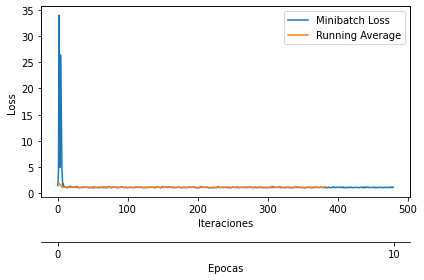

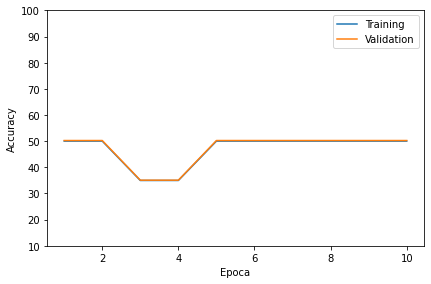

In [98]:
# Plot function de utils
plot_training_loss(minibatch_loss_list = minibatch_loss_list,
                   num_epochs = NUM_EPOCAS,
                   iter_per_epoch = len(train_loader),
                   averaging_iterations = 100)
plt.show()

plot_accuracy(train_acc_list=train_acc_list,
              valid_acc_list=valid_acc_list)
plt.ylim([10, 100])
plt.show()

> Al variar el Learning rate, de 0.001 a 0.005 podemos visualizar cuanto empeora el modelo.\
Con un learning rate mas grande, necesitas mas tiempo/epocas para converger a cero. Tal vez aumentar las epocas seria un approach al aumentar el learning rate.

**D) Cambiar el parámetro _batch_size_ y explicar por qué varía la cantidad de pasos en el entrenamiento al modificarlo**

> El **batch_size** es un subconjunto de los datos de entrenamiento que tomamos para entrenar.\
Existen dos approaches: entrenar nuestro data set en su totalidad o bien definir subconjuntos de menor dimension que utilizaremos para entrenar iterando sobre el total de datos. Cuanto mayor sea el batch_size, menor cantidad de pasos haran falta para cubrir la totalidad del dataset de entrenamiento.\
El valor de entrenar con batches reside en la capacidad de con menor cantidad de datos poder arribar a un resultado similar, con un costo computacional y de tiempo menor. Ganando además la capacidad de tomar decisiones intra-steps del entrenamiento. 

In [99]:
model_7= crear_modelo(24, 2, 2, 2, 0)
optimizer = torch.optim.Adam(model_7.parameters(), lr=0.001)
NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 256

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [100]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_7, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[-0.0082, -0.0173,  0.0329, -0.0475],
        [-0.0096, -0.0171,  0.0301, -0.0473],
        [-0.0046, -0.0210,  0.0336, -0.0511],
        ...,
        [-0.0051, -0.0188,  0.0259, -0.0430],
        [-0.0052, -0.0168,  0.0324, -0.0525],
        [-0.0073, -0.0159,  0.0375, -0.0485]], grad_fn=<AddmmBackward0>)
Targets tensor([2, 0, 2, 2, 2, 3, 3, 3, 3, 2, 2, 3, 2, 2, 3, 3, 2, 2, 2, 2, 2, 0, 2, 3,
        2, 2, 0, 2, 2, 3, 3, 0, 3, 3, 3, 3, 2, 3, 2, 3, 2, 2, 3, 3, 0, 3, 2, 3,
        2, 3, 0, 2, 2, 2, 0, 0, 2, 2, 0, 2, 2, 3, 2, 2, 0, 2, 1, 3, 3, 2, 2, 3,
        3, 2, 3, 3, 2, 3, 2, 3, 2, 0, 3, 2, 3, 0, 2, 3, 0, 2, 2, 0, 3, 3, 3, 2,
        2, 2, 3, 3, 3, 2, 3, 2, 2, 3, 3, 2, 3, 2, 3, 3, 3, 0, 2, 3, 2, 0, 2, 2,
        3, 3, 2, 0, 0, 2, 0, 0, 2, 3, 2, 2, 3, 2, 0, 3, 2, 2, 2, 2, 2, 3, 3, 2,
        2, 3, 2, 2, 3, 3, 0, 3, 2, 2, 0, 3, 3, 2, 2, 2, 3, 3, 2, 2, 2, 3, 3, 0,
        2, 0, 2, 2, 3, 2, 3, 2, 2, 3, 2, 0, 2, 0, 2, 0, 2, 2, 3, 3, 2, 0, 0, 0,
        0, 2, 3

> Variando el batch size de 128 a 256, y manteniendo los demas hiperparametros constantes, perdemos poder de prediccion.\
El resultado de nuestra accuracy es **67.77** versus **96.45%** del modelo2 que es el que mejor ajusta.

**E) Aumentar la cantidad de _epocs_. Observar cómo se comportan las curvas de aprendizaje**

In [101]:
model_8 = crear_modelo(24, 2, 2, 2, 0)
optimizer = torch.optim.Adam(model_8.parameters(), lr=0.001)
NUM_EPOCAS = 15
valid_size = 0.2
batch_size = 128

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [102]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_8, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS, 
                                                                      batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[ 1.8395e-02,  4.8363e-02,  9.7624e-04,  7.9049e-03],
        [ 2.0566e-02,  5.2387e-02, -2.2874e-03,  9.6855e-03],
        [ 1.5347e-02,  5.2755e-02,  2.3533e-03,  1.2332e-02],
        [ 1.6799e-02,  4.6799e-02,  2.4252e-03,  1.0100e-02],
        [ 1.3663e-02,  4.8451e-02,  2.9505e-04,  1.0121e-02],
        [ 1.9764e-02,  4.8801e-02,  7.5448e-04,  7.6100e-03],
        [ 1.4561e-02,  5.5162e-02,  2.0189e-03,  9.6261e-03],
        [ 1.4885e-02,  5.0822e-02, -6.8867e-04,  9.2778e-03],
        [ 1.4289e-02,  4.8348e-02, -1.8109e-03,  2.5698e-03],
        [ 1.4749e-02,  4.9175e-02, -1.9425e-03,  8.3243e-03],
        [ 1.6584e-02,  5.2485e-02, -1.5881e-03,  6.1674e-03],
        [ 1.4833e-02,  4.8584e-02, -2.3949e-03,  1.4149e-02],
        [ 1.3419e-02,  4.7103e-02,  3.3260e-03,  9.1040e-03],
        [ 1.7376e-02,  5.2145e-02, -1.1570e-03,  9.1625e-03],
        [ 1.3533e-02,  5.1307e-02,  6.8899e-04,  1.3653e-02],
        [ 1.6132e-02,  4.9579e-02,  2.3017e-03,  

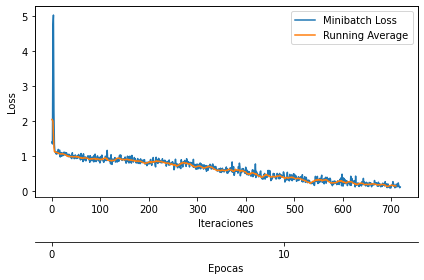

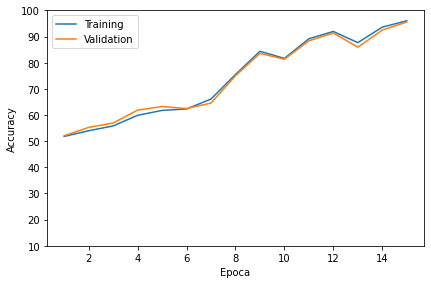

In [104]:
plot_training_loss(minibatch_loss_list = minibatch_loss_list,
                   num_epochs = NUM_EPOCAS,
                   iter_per_epoch = len(train_loader),
                   averaging_iterations = 10)
plt.show()

plot_accuracy(train_acc_list=train_acc_list,
              valid_acc_list=valid_acc_list)
plt.ylim([10, 100])
plt.show()

> Aumentar la cantidad de epochs hace que las loss ratio converga hacia el cero, pero a partir de la epoca 12, la convergencia tiene una pendiente cada vez menor.\
Si observamos los pasos que realiza nuestra red con respecto al accuracy, hay ciertas epocas donde el modelo pierde capacidad de prediccion, pero la convergencia final siempre es de pendiente positiva.

**F) Agregar una capa convolucional, una capa de max pooling y una capa lineal de manera tal que la red siga funcionando. Explicar la elección de dimensiones para que la red sea funcional.**

La relación de dimensiones fue explicada anteriormente, a continuación definimos una nueva arquitectura en base a lo solicitado:

In [113]:
class LeMateNet(nn.Module):
    # Aguante el Mate
    def __init__(self, n_canales_rgb, n_clases, cantidad_filtros_conv, tamaño_filtro_conv, 
                 tamaño_kernel_pooling, stride, padding):
        super().__init__()
        # cantidad de canales y clases, a definir por el diseñador
        self.n_canales_rgb = n_canales_rgb
        self.n_clases = n_clases
        self.tamaño_kernel_pooling = tamaño_kernel_pooling

        self.conv1 = nn.Conv2d(self.n_canales_rgb, cantidad_filtros_conv, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv1 = math.floor(((128 - tamaño_filtro_conv + 2 * padding)/stride) + 1)
        
        print("imagenes de salida post convolucion1:", outputconv1, "x", outputconv1)
        outputconv1 = math.floor(((outputconv1 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling1:", outputconv1, "x", outputconv1)
        
        self.conv2 = nn.Conv2d(cantidad_filtros_conv, cantidad_filtros_conv*4, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv2 = math.floor((((outputconv1 - tamaño_filtro_conv)+ 2 * padding)/stride) + 1)
        
        print("imagenes de salida post convolucion2:", outputconv2, "x", outputconv2)
        outputconv2 = math.floor(((outputconv2 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling2:", outputconv2, "x", outputconv2)
        
        # Agregamos una tercer capa convolucional 
        self.conv3 = nn.Conv2d(cantidad_filtros_conv*4, cantidad_filtros_conv*6, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv3 = math.floor((((outputconv2 - tamaño_filtro_conv)+ 2 * padding)/stride) + 1)
        print("imagenes de salida post convolucion3:", outputconv3, "x", outputconv3)
        outputconv3 = math.floor(((outputconv3 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling3:", outputconv3, "x", outputconv3)
        
        # size del vector de parametros luego de las capas convolucionales
        cantidad_parametros = math.floor(cantidad_filtros_conv *4 * outputconv2 * outputconv2)
        print("cantidad de parametros en unrolling:",cantidad_parametros)
        # y tres capas de MLPs
        
        # primer MLP
        inputfc1 = math.floor(cantidad_parametros)
        print("parametros de entrada del primer perceptron:", inputfc1)
        outputfc1 = math.floor((1/2)*inputfc1)
        print("parametros de salida del primer perceptron:", outputfc1)
        
        self.fc1 = torch.nn.Linear(inputfc1, outputfc1)
        # segundo MLP
        inputfc2 = outputfc1
        print("parametros de entrada del segundo perceptron:", inputfc2)
        outputfc2 = math.floor(inputfc2*(1/2))
        print("parametros de salida del segundo perceptron:", outputfc2)
        self.fc2 = torch.nn.Linear(inputfc2, outputfc2)
        # tercer MLP. salida con cantidad de clases
        inputfc3 = outputfc2
        print("parametros de entrada del tercer perceptron:", inputfc3)
        outputfc3 = math.floor(inputfc3*(1/2))
        self.fc3 = torch.nn.Linear(inputfc3, outputfc3)
        print("parametros de entrada del cuarto perceptron:", outputfc3)
        self.fc4 = torch.nn.Linear(outputfc3, self.n_clases)

    def forward(self, x):
        # capa convolucional
        x = self.conv1(x)
        # al resultado de la convolucion, le aplica una ReLu
        x = F.relu(x)
        # y luego un pooling
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        
        # Segunda capa convolucional
        x = self.conv2(x)
        # aplica relu
        x = F.relu(x)
        # pooling 
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        
        # flatten de las imagenes para pasarlo a MLPs
        x = torch.flatten(x, 1)
        # MLPs con relus
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = self.fc4(x)
        
        return x

In [114]:
def crear_modeloMATE(cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding):
    # Instanciamos la clase del modelo:
    model = LeMateNet(3, 4, cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding)
    # CUDA / CPU
    model = model.to('cpu')
    return model

# le mate net
model_mate = crear_modeloMATE(24, 2, 2, 2, 0)

NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

optimizer = torch.optim.Adam(model_mate.parameters(), lr= 0.001)

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
imagenes de salida post convolucion3: 4 x 4
imagenes de salida post pooling3: 2 x 2
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536
parametros de entrada del cuarto perceptron: 768


In [115]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_mate, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS,batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[ 1.0674e-02, -2.9471e-02, -5.2686e-03, -2.4203e-03],
        [ 1.1975e-02, -3.2585e-02, -5.3488e-03, -2.4442e-03],
        [ 1.0301e-02, -3.1133e-02, -3.7649e-03, -7.4949e-04],
        [ 1.1731e-02, -3.1470e-02, -3.1534e-03, -1.9547e-03],
        [ 1.1383e-02, -3.1719e-02, -3.7253e-03, -1.9315e-03],
        [ 1.2609e-02, -3.1702e-02, -3.8184e-03, -3.1526e-03],
        [ 1.0602e-02, -3.2989e-02, -4.0220e-03, -3.6282e-04],
        [ 1.2297e-02, -3.1534e-02, -4.9499e-03, -2.3947e-03],
        [ 1.2260e-02, -3.2087e-02, -4.5823e-03, -7.6405e-04],
        [ 1.2236e-02, -3.1084e-02, -3.5081e-03, -9.3539e-04],
        [ 1.1821e-02, -3.0814e-02, -4.2963e-03, -2.2658e-03],
        [ 1.2123e-02, -3.2257e-02, -3.6047e-03, -8.1636e-04],
        [ 1.0946e-02, -3.1408e-02, -3.6676e-03, -3.0336e-03],
        [ 1.2212e-02, -3.1948e-02, -4.3900e-03, -1.9043e-03],
        [ 1.1257e-02, -3.2404e-02, -4.4706e-03, -1.8832e-03],
        [ 1.1720e-02, -3.0785e-02, -5.0299e-03, -

> Nuestra MateNet logro una Accuracy de **97.19%** vs **96.45%** del modelo2, manteniendo los hiperparametros pero diferenciando la arquitectura en base a lo solicitado.

**G) Reemplazar la red convolucional por un perceptrón multicapa. Variar la cantidad de capass y neuronaes y comprar los resultados**

In [77]:
class Net(nn.Module):
    
    def __init__(self):
        super(Net, self).__init__()
        self.fc1 = nn.Linear(128 * 128 * 3, 4096)
        self.fc2 = nn.Linear(4096, 512)
        self.fc3 = nn.Linear(512, 64)
        self.fc4 = nn.Linear(64, 4)

    def forward(self, x):
        # flatten image input
        x = x.view(-1, 128 * 128 * 3)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.softmax(self.fc4(x), dim=1)
        return x

modelMLP = Net()
print(modelMLP)

Net(
  (fc1): Linear(in_features=49152, out_features=4096, bias=True)
  (fc2): Linear(in_features=4096, out_features=512, bias=True)
  (fc3): Linear(in_features=512, out_features=64, bias=True)
  (fc4): Linear(in_features=64, out_features=4, bias=True)
)


In [81]:
# especificar funcion de perdida
criterion = nn.CrossEntropyLoss()

# algoritmo de optimizacion: descenso del gradiente
optimizer = torch.optim.Adam(modelMLP.parameters(), lr=0.001)

NUM_EPOCAS = 3
valid_size = 0.2
batch_size = 128

In [82]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(modelMLP, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS,batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 1., 0.],
        [0., 0., 

> Utilizando una estructura de cuatro perceptrones que componen el Perceptron Multicapa, el modelo solo es capaz de predecir la clase 2, que corresponde al estado Mild.\
Habria que analizar cual es la limitacion de la estructura. Sin restriccion de tiempos y tamanos, el MLP seria capaz de predecir con la misma accuracy que las estructuras de CNNs que utilizamos antes?\
Por una restriccion logica de computos, no tenemos la capacidad como para entrenarlo exhaustivamente. Esto demuestra la bondad de las CNNs que nos permiten avanzar a precisiones mayores con pendientes mas pronunciadas.

> ## Ejercicio 2: Regularización


**A) Implementar _dropout_ y _penalidad L2_. Explicar ambos conceptos**

> El **dropout** consiste en desactivar aleatoriamente ciertas neuronas durante el entrenamiento para mejorar la performance de las demas y evitar la memorización de la información.

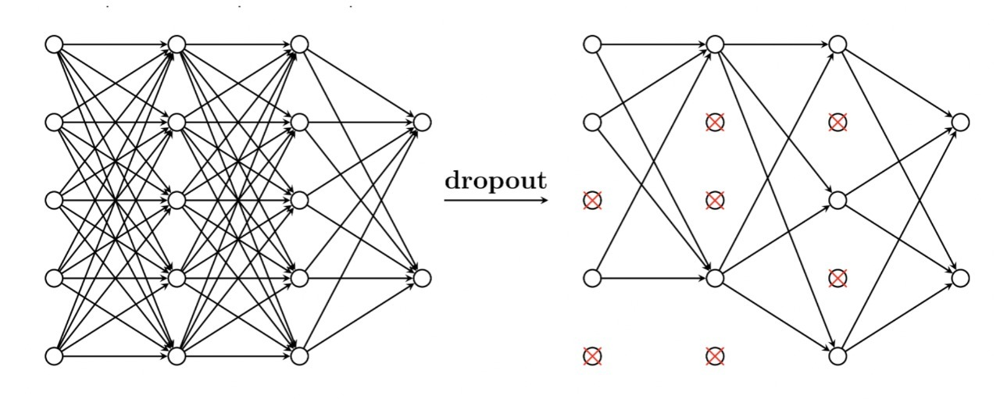

> La **penalidad L2** consiste en imponer una penalidad (matemática) específica sobre los parámetros de aprendizaje. Esto es útil para aprender problemas mas complejos

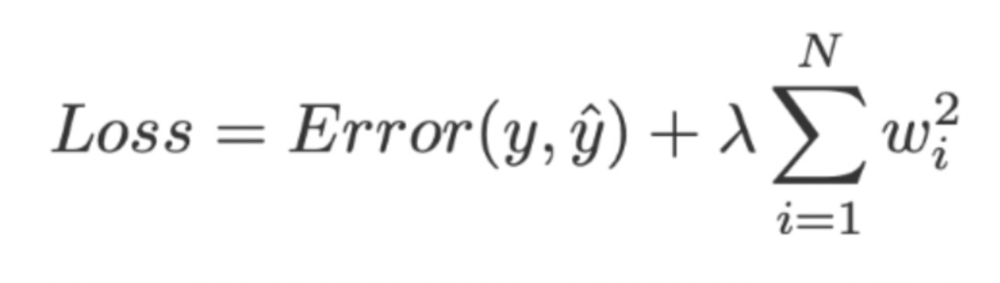

> Implementacion de la red con nuevas caracteristicas.

In [18]:
class LeNet5dropout(nn.Module):

    def __init__(self, n_canales_rgb, n_clases, cantidad_filtros_conv, tamaño_filtro_conv, 
                 tamaño_kernel_pooling, stride, padding):
        super().__init__()
        # cantidad de canales y clases, a definir por el diseñador
        self.n_canales_rgb = n_canales_rgb
        self.n_clases = n_clases
        self.tamaño_kernel_pooling = tamaño_kernel_pooling
        # Le net tiene dos capas convolucionales
        self.conv1 = nn.Conv2d(self.n_canales_rgb, cantidad_filtros_conv, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv1 = math.floor(((128 - tamaño_filtro_conv + 2 * padding)/stride) + 1)
        # outputconv1 = math.floor(((128 - tamaño_filtro_conv)/stride))
        # falta un +1 al final ?? tener en cuenta el padding
        # asi seria? outputconv1 = math.floor(((128 - tamaño_filtro_conv + 2* padding)/stride) + 1)
        
        print("imagenes de salida post convolucion1:", outputconv1, "x", outputconv1)
        outputconv1 = math.floor(((outputconv1 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling1:", outputconv1, "x", outputconv1)
        
        self.conv2 = nn.Conv2d(cantidad_filtros_conv, cantidad_filtros_conv*4, kernel_size=tamaño_filtro_conv, stride=stride, padding=padding)
        
        outputconv2 = math.floor((((outputconv1 - tamaño_filtro_conv)+ 2 * padding)/stride) + 1)
        print("imagenes de salida post convolucion2:", outputconv2, "x", outputconv2)
        outputconv2 = math.floor(((outputconv2 - tamaño_kernel_pooling)/ stride ) + 1)
        print("imagenes de salida post pooling2:", outputconv2, "x", outputconv2)

        # size del vector de parametros luego de las capas convolucionales
        cantidad_parametros = math.floor(cantidad_filtros_conv *4 * outputconv2 * outputconv2)
        print("cantidad de parametros en unrolling:",cantidad_parametros)
        # y tres capas de MLPs
        
        # primer MLP
        inputfc1 = math.floor(cantidad_parametros)
        print("parametros de entrada del primer perceptron:", inputfc1)
        outputfc1 = math.floor((1/2)*inputfc1)
        print("parametros de salida del primer perceptron:", outputfc1)
        
        self.fc1 = torch.nn.Linear(inputfc1, outputfc1)
        # segundo MLP
        inputfc2 = outputfc1
        print("parametros de entrada del segundo perceptron:", inputfc2)
        outputfc2 = math.floor(inputfc2*(1/2))
        print("parametros de salida del segundo perceptron:", outputfc2)
        self.fc2 = torch.nn.Linear(inputfc2, outputfc2)
        # tercer MLP. salida con cantidad de clases
        inputfc3 = outputfc2
        print("parametros de entrada del tercer perceptron:", inputfc3)
        self.fc3 = torch.nn.Linear(inputfc3, self.n_clases)
        
        # dropout
        self.dropout = nn.Dropout(0.25)

    def forward(self, x):
        # capa convolucional
        x = self.conv1(x)
        # al resultado de la convolucion, le aplica una ReLu
        x = F.relu(x)
        # y luego un pooling
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        x = self.dropout(x)
        
        # Segunda capa convolucional
        x = self.conv2(x)
        # aplica relu
        x = F.relu(x)
        # pooling 
        x = F.max_pool2d(x, (self.tamaño_kernel_pooling, self.tamaño_kernel_pooling))
        x = self.dropout(x)
        
        # flatten de las imagenes para pasarlo a MLPs
        x = torch.flatten(x, 1)
        # MLPs con relus
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = self.dropout(x)
        x = self.fc3(x)
        
        return x

In [19]:
def crear_modelodropout(cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding):
    # Instanciamos la clase del modelo:
    model = LeNet5dropout(3, 4, cantidad_filtros_conv, tamaño_filtro_conv, tamaño_kernel_pooling, stride, padding)
    # CUDA / CPU
    model = model.to('cpu')
    return model

In [20]:
model_dropout = crear_modelodropout(24, 2, 2, 2, 0)

NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

optimizer = torch.optim.Adam(model_dropout.parameters(), lr= 0.001)

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [21]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_dropout, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS,batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[-0.0222,  0.0263, -0.0114, -0.0314],
        [ 0.0224,  0.0498, -0.0436,  0.0070],
        [-0.0051,  0.0079, -0.0388, -0.0117],
        [-0.0203,  0.0195, -0.0267,  0.0050],
        [ 0.0105,  0.0446, -0.0170, -0.0041],
        [-0.0228,  0.0433, -0.0023,  0.0275],
        [ 0.0179,  0.0058, -0.0215,  0.0108],
        [-0.0184,  0.0264, -0.0152, -0.0129],
        [-0.0147,  0.0317, -0.0436, -0.0100],
        [ 0.0156,  0.0257, -0.0196,  0.0247],
        [ 0.0269,  0.0199, -0.0149,  0.0273],
        [ 0.0076,  0.0516, -0.0323,  0.0346],
        [ 0.0063,  0.0182, -0.0200,  0.0240],
        [ 0.0075,  0.0288,  0.0026, -0.0186],
        [ 0.0187,  0.0245,  0.0087,  0.0157],
        [ 0.0047,  0.0342, -0.0201, -0.0081],
        [-0.0117,  0.0434, -0.0476, -0.0030],
        [-0.0116,  0.0550, -0.0341,  0.0057],
        [ 0.0086,  0.0047, -0.0490,  0.0085],
        [ 0.0105,  0.0181, -0.0180, -0.0057],
        [-0.0035,  0.0464, -0.0168, -0.0134],
        [ 0.0

> La utlizacion de una arquitectura igual a la inicial, agregandole dropouts de las redes, genero una perdida significativa de la capacidad de prediccion de nuestra CNN. De valores cercanos al **95% a 60%**

> **Implementación Penalización L2**

Segun la documentación de PyTorch, agregar una penalización L2 es equivalente a agregar un parametro weight decay >0 al optimizer. 

>Adding L2 regularization to the loss function is equivalent to decreasing each weight by an amount proportional to its current value during the optimization step. L2 regularization is also referred to as weight decay.
The SGD optimizer in PyTorch already has a weight_decay parameter that corresponds to 2 * lambda, and it directly performs weight decay during the update as described previously. It is fully equivalent to adding the L2 norm of weights to the loss, without the need for accumulating terms in the loss and involving autograd. Note that weight decay applies to all parameters of the network, such as biases.

Luego:

In [22]:
model_L2 = crear_modelo(24, 2, 2, 2, 0)

NUM_EPOCAS = 10
valid_size = 0.2
batch_size = 128

optimizer = torch.optim.Adam(model_L2.parameters(), lr= 0.001, weight_decay = 1e-5)

imagenes de salida post convolucion1: 64 x 64
imagenes de salida post pooling1: 32 x 32
imagenes de salida post convolucion2: 16 x 16
imagenes de salida post pooling2: 8 x 8
cantidad de parametros en unrolling: 6144
parametros de entrada del primer perceptron: 6144
parametros de salida del primer perceptron: 3072
parametros de entrada del segundo perceptron: 3072
parametros de salida del segundo perceptron: 1536
parametros de entrada del tercer perceptron: 1536


In [23]:
minibatch_loss_list, train_acc_list, valid_acc_list, train_loader = entrenar_modelo(model_L2, 
                                                                      optimizer, 
                                                                      NUM_EPOCAS,batch_size, 
                                                                      train_data, 
                                                                      val_data, 
                                                                      test_data)

salida prop adelante tensor([[-2.3504e-02, -1.3444e-03,  1.7444e-02, -3.5798e-02],
        [-7.1286e-03,  3.0541e-02, -1.7645e-02, -3.9145e-03],
        [-2.8877e-02,  6.6098e-03,  1.5485e-02, -2.8392e-02],
        [-5.3604e-03,  1.1323e-02,  1.9944e-02, -3.1090e-02],
        [-2.0174e-02, -3.9487e-03,  2.2160e-02, -2.5142e-02],
        [-2.6914e-02,  1.2519e-02, -9.3902e-04, -6.6307e-03],
        [-1.3433e-02, -6.5729e-03,  1.9936e-02, -1.1207e-02],
        [ 1.4061e-03,  3.3894e-03,  7.4199e-03, -5.5092e-03],
        [-9.1783e-03, -4.9235e-03,  1.2284e-02, -2.0517e-02],
        [-2.9180e-02,  1.1648e-02, -6.4256e-03, -1.9403e-02],
        [-1.9081e-02, -9.4342e-03, -5.4408e-03, -4.8208e-02],
        [-1.2034e-02,  4.0497e-03, -2.3152e-02, -4.6123e-02],
        [ 1.3508e-02,  2.3746e-02, -2.0875e-03, -1.0211e-02],
        [-3.3848e-02,  2.0245e-03,  1.8027e-02, -2.7530e-02],
        [-2.9373e-03,  4.6933e-03,  1.2078e-03, -5.4184e-02],
        [-3.1417e-02, -8.6455e-03,  1.6682e-02, -

> La prueba con early stopping otorgo una Accuracy del 54%.

> ## Ejercicio 3: Validación


**A) Armar un set de validación separando parte del set de entrenamiento.**

Lo realizamos desde el inicio. Nos permite iterar momento a momento en el Train Set para observar como nuestro modelo va ajustando en base al Optimizer.\
No utilizar un set de validacion obliga a recorrer el Train Set de principio a fin antes de Testearlo. Puede ser computacionalmente muy intenso, y llevar mucho timepo.

**B) Implementar _early stopping_. Explicar para que sirve**

> El Early Stopping es una técnica que nos permite ahorrarnos pasos de entrenamiento (cortandolo automaticamente) una vez que el aprendizaje ya no genera mejoras significativas en la reducción de la Loss Function, evitando de esta forma el overfitting y el desperdicio de tiempo y recursos de entrenamiento.

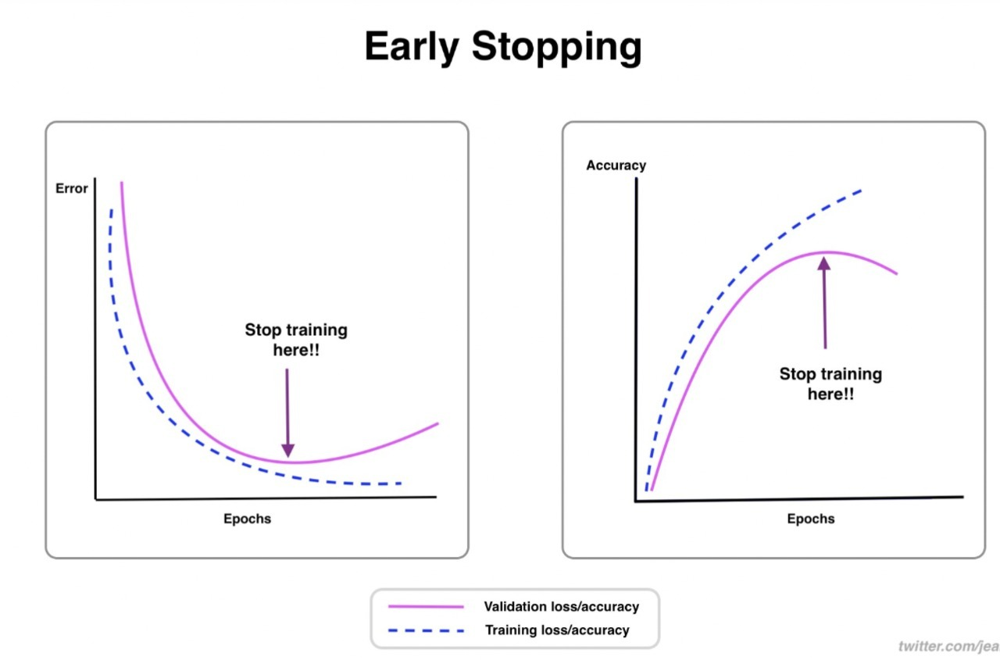

> **Utilizamos la implementacion del curso, solamente ajustando parametros y valores a nuestro trabajo.**

In [45]:
criterion = nn.CrossEntropyLoss()

optimizer = torch.optim.Adam(model_2.parameters(), lr=0.001)

In [46]:
class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=7, verbose=False, delta=0, path='checkpoint.pt', trace_func=print):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
            path (str): Path for the checkpoint to be saved to.
                            Default: 'checkpoint.pt'
            trace_func (function): trace print function.
                            Default: print            
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.path = path
        self.trace_func = trace_func
    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            self.trace_func(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            self.trace_func(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss

In [53]:
def train_model_ES(model, batch_size, patience, n_epochs):
    
    train_loader = torch.utils.data.DataLoader(train_data,
                                               batch_size=batch_size,
                                               shuffle = True,                                        
                                               num_workers=0)

    valid_loader = torch.utils.data.DataLoader(val_data,
                                               batch_size=batch_size,
                                               shuffle = True,
                                               num_workers=0)

    test_loader = torch.utils.data.DataLoader(test_data,
                                              batch_size=batch_size,
                                              shuffle = True,
                                              num_workers=0)
    
    train_losses = []

    valid_losses = []

    avg_train_losses = []

    avg_valid_losses = [] 
    
    early_stopping = EarlyStopping(patience=patience, verbose=True)
    
    for epoch in range(1, n_epochs + 1):

        # entrenamiento del modelo
        model.train()
        for batch, (data, target) in enumerate(train_loader, 1):
            optimizer.zero_grad()
            output = model(data)
            loss = criterion(output, target)
            loss.backward()
            optimizer.step()
            train_losses.append(loss.item())

        # evaluar modelo
        model.eval()
        for data, target in valid_loader:
            output = model(data)
            loss = criterion(output, target)
            valid_losses.append(loss.item())

        train_loss = np.average(train_losses)
        valid_loss = np.average(valid_losses)
        avg_train_losses.append(train_loss)
        avg_valid_losses.append(valid_loss)
        
        epoch_len = len(str(n_epochs))
        
        print_msg = (f'[{epoch:>{epoch_len}}/{n_epochs:>{epoch_len}}] ' +
                     f'train_loss: {train_loss:.5f} ' +
                     f'valid_loss: {valid_loss:.5f}')
        
        print(print_msg)
        
        train_losses = []
        valid_losses = []
        
        early_stopping(valid_loss, model)
        
        if early_stopping.early_stop:
            print("Early stopping")
            break
        
    # Cargar el mejor modelo guardado
    model.load_state_dict(torch.load('checkpoint.pt'))

    return  model, avg_train_losses, avg_valid_losses

In [54]:
batch_size = 128
n_epochs = 10

patience = 20

model, train_loss, valid_loss = train_model_ES(model_2, batch_size, patience, n_epochs)

[ 1/10] train_loss: 0.92702 valid_loss: 0.86244
Validation loss decreased (inf --> 0.862440).  Saving model ...
[ 2/10] train_loss: 0.85937 valid_loss: 0.82117
Validation loss decreased (0.862440 --> 0.821168).  Saving model ...
[ 3/10] train_loss: 0.77492 valid_loss: 0.65453
Validation loss decreased (0.821168 --> 0.654529).  Saving model ...
[ 4/10] train_loss: 0.58721 valid_loss: 0.42935
Validation loss decreased (0.654529 --> 0.429348).  Saving model ...
[ 5/10] train_loss: 0.38301 valid_loss: 0.29999
Validation loss decreased (0.429348 --> 0.299994).  Saving model ...
[ 6/10] train_loss: 0.22045 valid_loss: 0.16313
Validation loss decreased (0.299994 --> 0.163131).  Saving model ...
[ 7/10] train_loss: 0.12805 valid_loss: 0.08342
Validation loss decreased (0.163131 --> 0.083421).  Saving model ...
[ 8/10] train_loss: 0.08963 valid_loss: 0.17507
EarlyStopping counter: 1 out of 20
[ 9/10] train_loss: 0.05362 valid_loss: 0.05497
Validation loss decreased (0.083421 --> 0.054973).  Sav

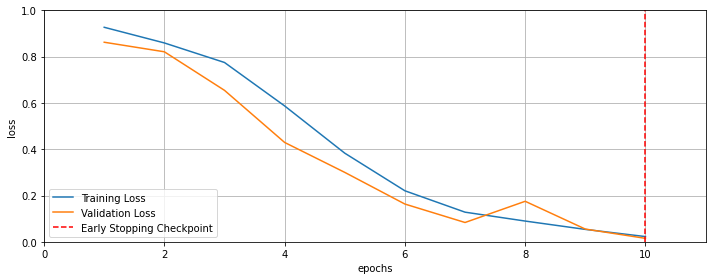

In [59]:
fig = plt.figure(figsize=(10,4))
plt.plot(range(1,len(train_loss)+1),train_loss, label='Training Loss')
plt.plot(range(1,len(valid_loss)+1),valid_loss,label='Validation Loss')

# find position of lowest validation loss
minposs = valid_loss.index(min(valid_loss))+1 
plt.axvline(minposs, linestyle='--', color='r',label='Early Stopping Checkpoint')

plt.xlabel('epochs')
plt.ylabel('loss')
plt.ylim(0, 1) # consistent scale
plt.xlim(0, len(train_loss)+1) # consistent scale
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()
fig.savefig('loss_plot.png', bbox_inches='tight')

> Se podria implementar una cantidad de epochs considerable, y permitir que el modelo solo stoppee cuando verifique las condiciones.
Utilizando solo 10 epochs, la curva sigue decreciendo, no esta completamente definida todavia la limitacion del modelo. 